In [1]:
import numpy as np
import pandas as pd
#from hetdex_api.amp_widget import AmpWidget
from hetdex_api.shot import get_image2D_amp
import matplotlib.pyplot as plt
%matplotlib inline
from astropy.visualization import ZScaleInterval

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
allpredictions = np.load('saved_predictions/predictions_hdr2.1.npy', allow_pickle=True)
preds_df = pd.DataFrame(allpredictions[1:], columns=allpredictions[0])

In [4]:
preds_df.columns
print(preds_df.head())

        shotid expnum            multiframe   norm N_cont background  \
0  20170103002      1  multi_004_106_033_LL  1.016    0.0       0.07   
1  20170103002      2  multi_051_105_051_LL  1.147   26.0       0.59   
2  20170103002      2  multi_051_105_051_LU  1.144   28.0       0.62   
3  20170103002      2  multi_051_105_051_RL  1.187   15.0      -1.13   
4  20170103002      2  multi_051_105_051_RU  1.059    8.0      -0.48   

  sky_sub_rms wave0 wave1 nfib_bad  ... flag ft_flag flag_badamp flag_auto  \
0       13.84   0.0 -0.08      0.0  ...    1       1           0         1   
1       19.17 -6.42 -0.08      0.0  ...    1       1           0         1   
2       20.88 -6.67 -0.32      0.0  ...    0       1           1         1   
3       17.45 -0.08  0.32      0.0  ...    1       1           0         1   
4       15.49 -0.33  0.08      0.0  ...    1       1           0         1   

  flag_badamp_not_auto manual_prob  net_prob  cut_prob notauto_prob  \
0                    0    0

In [5]:
newflag, oldflag = 'notauto_hyperopt_prob', 'notauto_prob'
#inds = np.where((preds_df[newflag] > 0.5 ) & (preds_df[oldflag] < 0.5) & (preds_df['cut_flag'] == 1))[0]
inds = np.where((preds_df[newflag] < 0.95) & (preds_df['flag'] ==1))
#inds = np.where( (preds_df[newflag] < 0.95))

In [6]:
looparr = preds_df[['shotid','expnum','multiframe','flag_auto','notauto_prob', 'notauto_hyperopt_prob']]
looparr=looparr.iloc[inds]
looparr.head()


,shotid,expnum,multiframe,flag_auto,notauto_prob,notauto_hyperopt_prob
17,20170103002,3,multi_016_104_026_LL,1,1.0,0.915907
21,20170103002,2,multi_047_075_075_LL,1,0.603681,0.469902
52,20170103002,3,multi_047_075_075_LL,1,0.912835,0.257379
117,20170103002,1,multi_016_104_026_LL,1,1.0,0.92113
130,20170103002,2,multi_016_104_026_LL,1,1.0,0.891365


In [17]:
looparr = np.load('disagreements_netgood.npy',allow_pickle=True)
looparr = pd.DataFrame(looparr, columns = ['shotid','expnum','multiframe','flag_auto','notauto_hyperopt_prob'])

In [18]:
print(looparr.shape[0], 'bad amps')
print(np.round(looparr.shape[0] / preds_df.shape[0]* 100, 4), '% bad')

27 bad amps
0.0015 % bad


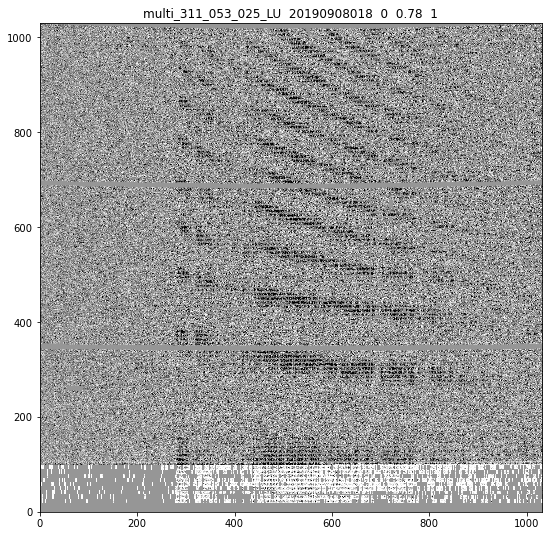

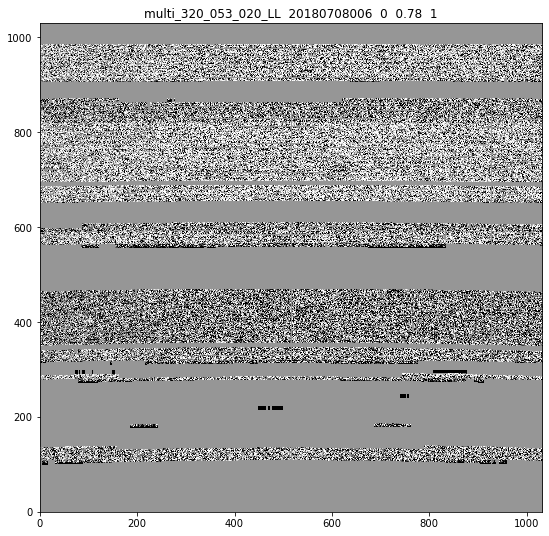

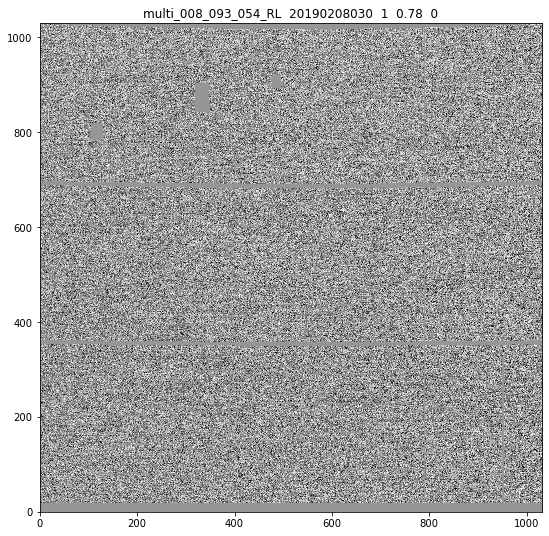

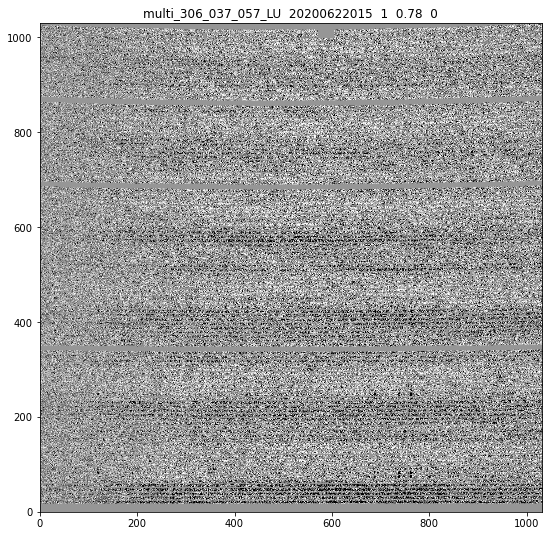

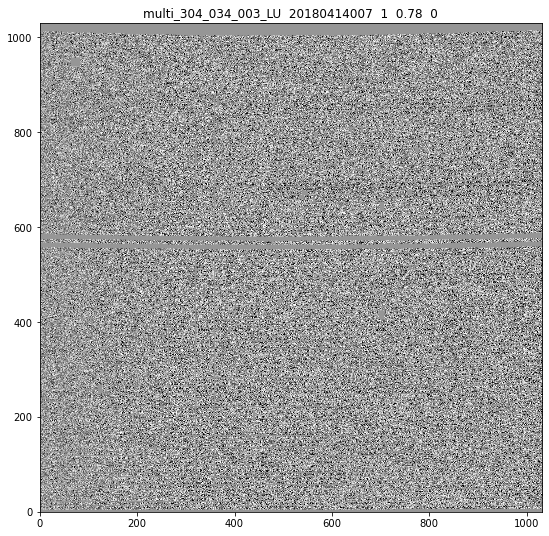

...

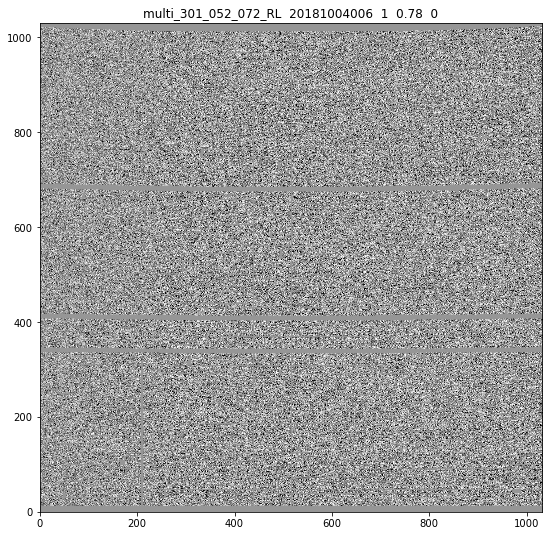

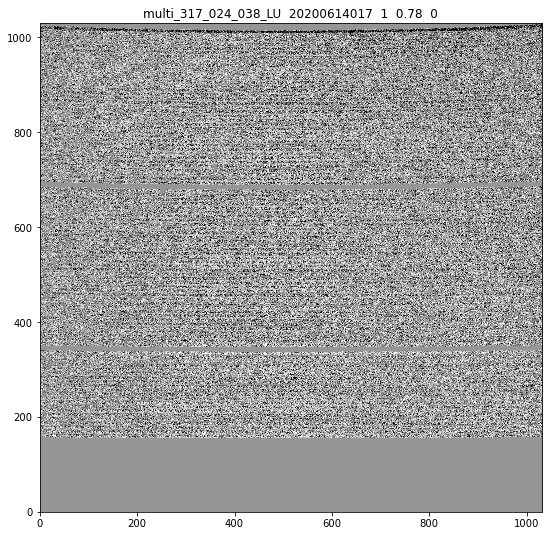

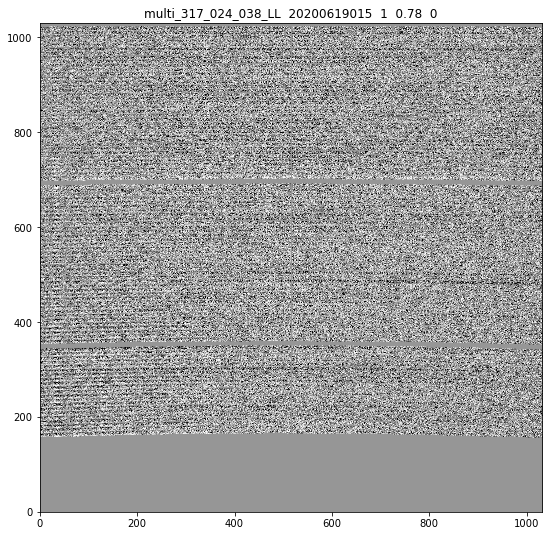

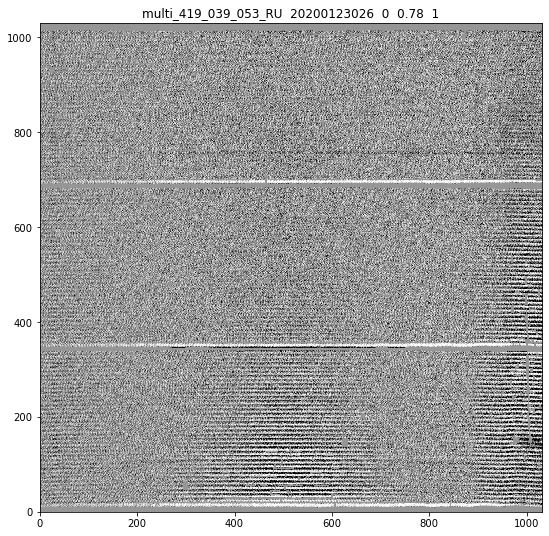

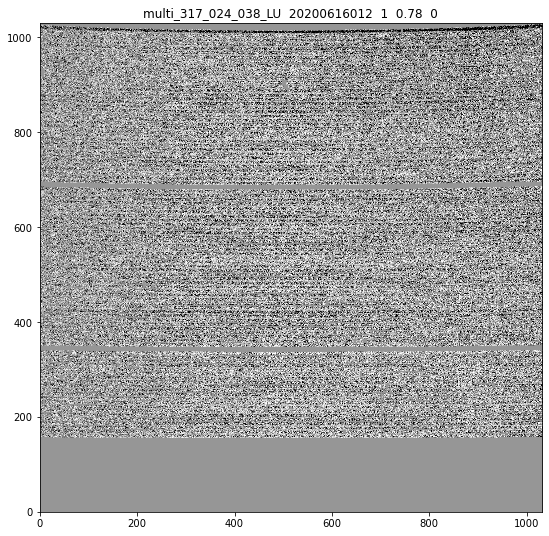

In [19]:
for (si, expnum, mf, cut, probnew) in looparr[0:50].values:
            im = get_image2D_amp(int(si), multiframe=mf, imtype='clean_image', 
                         survey='hdr2.1', expnum=int(expnum))
            zscale = ZScaleInterval(contrast=0.5, krej=2.5)
            vmin,vmax = zscale.get_limits(values=im)
            plt.figure(figsize=(9,9))
            plt.imshow(im, vmin=vmin, vmax=vmax, origin='lower', cmap='Greys', aspect='auto', interpolation='none')
            plt.title(mf + '  '+ str(si)+'  '+str(cut)+'  '+str(np.round(probold, 3))+'  '+str(np.round(probnew,3)))

3

In [22]:
hopt_prob = preds_df['notauto_hyperopt_prob']
mask = preds_df['flag'].astype('bool')

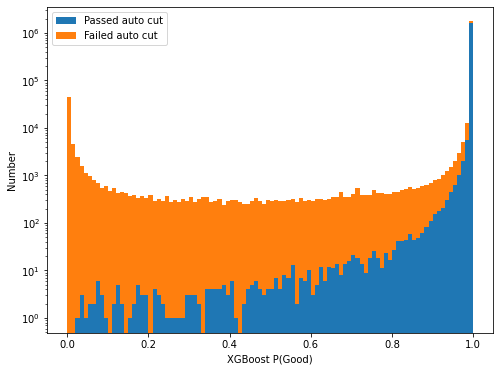

In [23]:
plt.figure(figsize=(8,6))
plt.hist((hopt_prob[mask], hopt_prob[~mask]),stacked=True,bins=100,label=('Passed auto cut', 'Failed auto cut'))
plt.yscale('log')
plt.legend()
plt.xlabel('XGBoost P(Good)')
plt.ylabel('Number')
plt.show()

In [8]:
hdr2predictions = np.load('saved_predictions/predictions_hdr2.npy', allow_pickle=True)
hdr2_df = pd.DataFrame(hdr2predictions[1:], columns=hdr2predictions[0])

In [9]:
hdr2_df.columns

Index(['shotid', 'expnum', 'multiframe', 'flag_manual', 'flag', 'ft_flag',
       'flag_badamp', 'flag_auto', 'flag_badamp_not_auto', 'manual_flag_prob',
       'net_flag_prob', 'cut_flag_prob', 'notauto_flag_prob'],
      dtype='object')

In [12]:
notauto = hdr2_df.notauto_flag_prob < 0.5

In [14]:
np.sum(notauto)

87131

In [22]:
print((len(preds_df) - len(hdr2_df))/len(hdr2_df))
print(len(hdr2_df))

0.47681193207606903
1857313


In [177]:
preds_df.columns

Index(['shotid', 'expnum', 'multiframe', 'norm', 'N_cont', 'background',
       'sky_sub_rms', 'wave0', 'wave1', 'nfib_bad', 'median_sky_rms',
       'stdev_sky_rms', 'sky_sub_rms_rel', 'im_median', 'MaskFraction',
       'flag_manual', 'flag', 'cut_flag', 'manual_prob', 'net_prob',
       'cut_prob', 'notauto_prob', 'notauto_hyperopt_prob'],
      dtype='object')

In [24]:
shotid = 20180810009
mf = 'multi_303_025_013_LU'
expnum = 1

In [25]:
smask = preds_df.shotid==shotid
mfmask = preds_df.multiframe==mf
emask = preds_df.expnum==expnum

In [26]:
weirdo = preds_df[smask & mfmask & emask]


In [27]:
for column in preds_df.columns:
    print(column, weirdo[column].values)

shotid [20180810009]
expnum [1]
multiframe ['multi_303_025_013_LU']
norm [0.977]
N_cont [0.0]
background [0.01]
sky_sub_rms [17.29]
wave0 [0.17]
wave1 [-0.24]
nfib_bad [0.0]
median_sky_rms [16.86]
stdev_sky_rms [1.6888570674999244]
sky_sub_rms_rel [1.0255041518386714]
im_median [23.890625]
MaskFraction [0.07017306652244457]
flag_manual [1]
flag [1]
ft_flag [1]
flag_badamp [False]
flag_auto [True]
flag_badamp_not_auto [False]
manual_prob [0.9999984502792358]
net_prob [1.0]
cut_prob [1.0]
notauto_prob [1.0]
notauto_hyperopt_prob [0.9999514818191528]
